# EDS – Artificial Intelligence HS25
**Kontakt**: markus.geiser@stud.hslu.ch

**Projektarbeit**: Automatische Erkennung von Kreiseln in SwissImage-Daten mittels YOLO & SAHI

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip install ultralytics
!pip install -q sahi
!pip install pyproj geopandas

# Grundlage aus Bachlorarbeit

In [ ]:
import geopandas as gpd
import numpy as np
import pandas as pd
from shapely.geometry import Polygon

# 1. Daten laden & CRS fixen
shp_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/gdf_kreisel.shp"
gdf_kreisel = gpd.read_file(shp_path)

if gdf_kreisel.crs is None:
    gdf_kreisel.set_crs(epsg=2056, inplace=True)

# 2. Gitter-Parameter (1000m x 1000m)
xmin, ymin, xmax, ymax = gdf_kreisel.total_bounds
grid_size = 1000

# Wir runden die Start-Koordinaten auf die nächsten 1000m ab,
# damit das Gitter "sauber" auf den Kilometer-Linien liegt (typisch für Rasterdaten)
xmin = np.floor(xmin / grid_size) * grid_size
ymin = np.floor(ymin / grid_size) * grid_size

cols = list(np.arange(xmin, xmax + grid_size, grid_size))
rows = list(np.arange(ymin, ymax + grid_size, grid_size))

# Gitter erstellen
polygons = []
grid_info = []
for x in cols[:-1]:
    for y in rows[:-1]:
        polygons.append(Polygon([(x, y), (x + grid_size, y), (x + grid_size, y + grid_size), (x, y + grid_size)]))
        # Speichere die linke untere Ecke als Referenzpunkt (Raster-ID)
        grid_info.append({'E_LV95': x, 'N_LV95': y})

grid = gpd.GeoDataFrame(grid_info, geometry=polygons, crs="EPSG:2056")

# 3. Räumliche Zählung
joined = gpd.sjoin(gdf_kreisel, grid, how='left', predicate='within')
# Zähle Kreisel pro Gitter-Index
counts = joined.groupby('index_right').size().reset_index(name='Anzahl_Kreisel')

# 4. Zusammenführen & als Tabelle ausgeben
raster_data = grid.merge(counts, left_index=True, right_on='index_right', how='left').fillna(0)
raster_data['Anzahl_Kreisel'] = raster_data['Anzahl_Kreisel'].astype(int)

# Nur Kacheln mit mindestens einem Kreisel anzeigen, sortiert nach Anzahl
raster_output = raster_data[raster_data.Anzahl_Kreisel > 0].sort_values(by='Anzahl_Kreisel', ascending=False)

# 5. Anzeige der Top-Werte
print("📋 TOP KACHELN (1000m x 1000m) MIT WERTEN:")
print(raster_output[['E_LV95', 'N_LV95', 'Anzahl_Kreisel']].head(10).to_string(index=False))

# Optional: Export als CSV für dein GitHub Repo
# raster_output[['E_LV95', 'N_LV95', 'Anzahl_Kreisel']].to_csv("kreisel_raster_1km.csv", index=False)

📋 TOP KACHELN (1000m x 1000m) MIT WERTEN:
   E_LV95    N_LV95  Anzahl_Kreisel
2709000.0 1268000.0              11
2499000.0 1115000.0               9
2719000.0 1081000.0               9
2562000.0 1122000.0               9
2562000.0 1123000.0               7
2593000.0 1119000.0               7
2665000.0 1207000.0               7
2593000.0 1245000.0               7
2499000.0 1116000.0               6
2570000.0 1163000.0               6


# Grundlage Luftbild von swisstopo

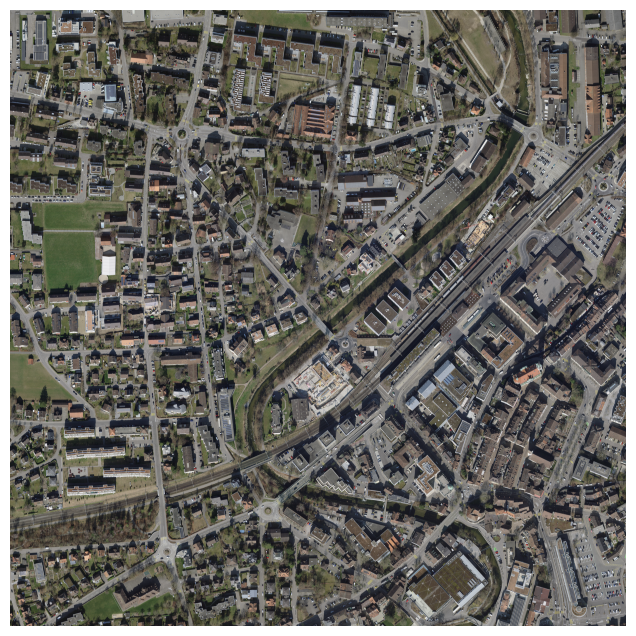

In [2]:
import rasterio
import matplotlib.pyplot as plt

img_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m/swissimage-dop10_2022_2709-1268_0.1_2056.tif"

with rasterio.open(img_path) as src:
    img = src.read()  # (Bands, Height, Width)

# Falls es ein RGB-Bild ist
img = img[:3].transpose(1, 2, 0)

plt.figure(figsize=(8, 8))
plt.imshow(img)
plt.axis("off")
plt.show()


# 1. Problemdefinition & Zielsetzung

**Kontext**

Die manuelle Erfassung von Strasseninfrastruktur ist zeitaufwendig. In diesem Projekt nutzen wir Deep Learning, um Kreisverkehrsanlagen (Kreisel) in den hochauflösenden Luftbildern von SwissImage (swisstopo) automatisch zu identifizieren.

**Zielsetzung**

Entwicklung einer End-to-End Pipeline, die:


1.   Rohdaten (TIF) und Geodaten (Shapefiles) für das Training aufbereitet.
2.   Ein Computer-Vision-Modell trainiert.

1.   Mittels SAHI (Slicing Aided Hyper Inference) Objekte in extrem grossen Bilddateien erkennt und die Koordinaten im

LV95-System ausgibt.

**Metrik**

Der Erfolg wird gemessen an:


*   mAP (mean Average Precision): Genauigkeit der Bounding Boxes.
*   Confidence Score: Ziel ist eine verlässliche Erkennung mit einem Schwellenwert von $\ge 0.8$.



# Test vortrainiertes YOLO-Modell

✅ Datei gefunden: /content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m/swissimage-dop10_2022_2709-1268_0.1_2056.tif
Performing prediction on 144 slices.
🔍 Objekte insgesamt gefunden: 1799
📍 Speziell Kreisel gefunden: 9
🖼️ Zeige Vorschau der erkannten Kreisel:


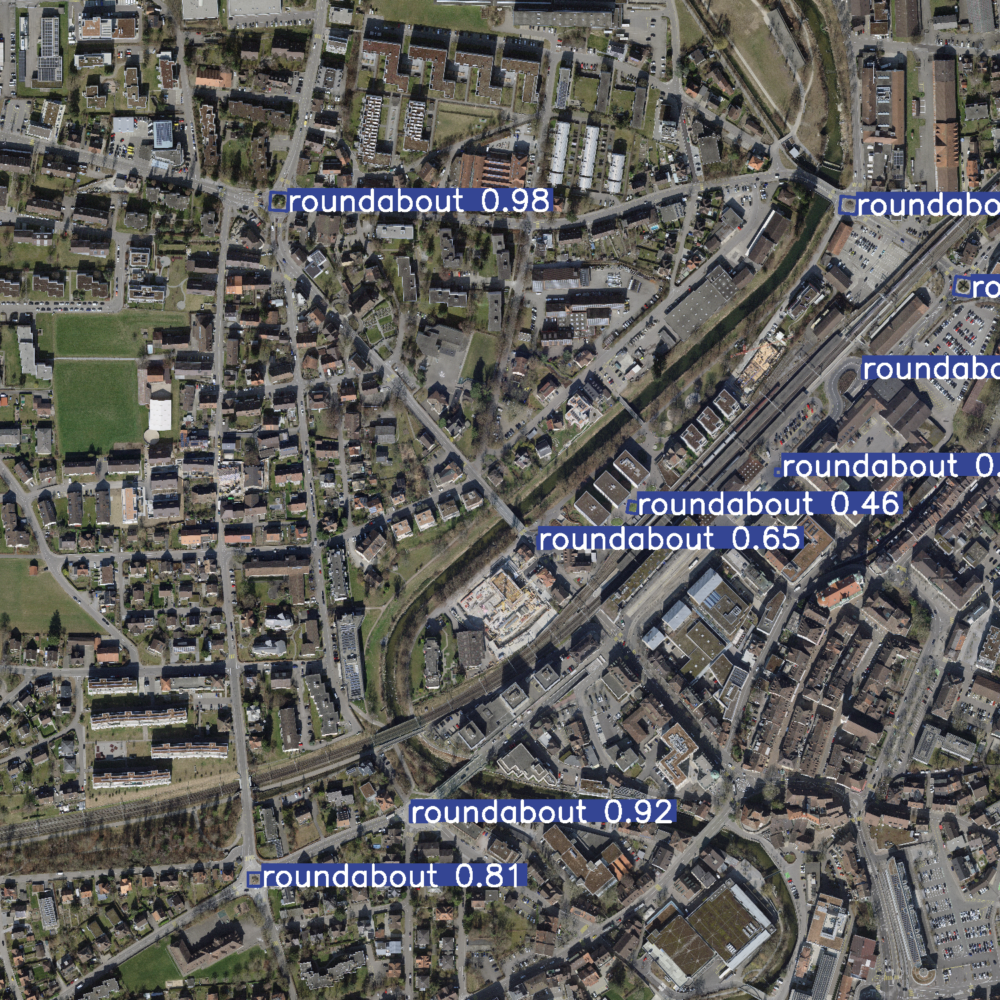

In [11]:
# Installation (YOLOv11 erfordert die aktuellste ultralytics Version)
#!pip install -U sahi ultralytics

from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from sahi.utils.cv import visualize_object_predictions, read_image
import cv2
import os
from google.colab.patches import cv2_imshow

# --- 1. KONFIGURATION ---
# Wir nutzen yolo11n-obb.pt (vortrainiert auf DOTA, inkl. Kreisel)
# Alternativen für mehr Präzision: 'yolo11s-obb.pt', 'yolo11m-obb.pt', 'yolo11l-obb.pt', 'yolo11x-obb.pt'
model_path = 'yolo11n-obb.pt'
img_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m/swissimage-dop10_2022_2709-1268_0.1_2056.tif"   #sursee swissimage-dop10_2024_2650-1225_0.1_2056.tif    11 kreisel swissimage-dop10_2022_2709-1268_0.1_2056.tif

# --- 2. MODELL LADEN ---
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8', # SAHI nutzt für v11 aktuell denselben Loader wie v8
    model_path=model_path,
    confidence_threshold=0.3,
    device="cuda",
)

# --- 3. BILD LADEN & PRÜFEN ---
if os.path.exists(img_path):
    print(f"✅ Datei gefunden: {img_path}")
    image = read_image(img_path)

    # 3. Sliced Prediction ausführen
    # Da Kreisel auf 0.1m Pixelgröße groß sind, wählen wir 1024er Slices
    result = get_sliced_prediction(
        image,
        detection_model,
        slice_height=1024,
        slice_width=1024,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2
    )

    # 4. Filter auf die Klasse 'roundabout'
    # Die DOTA-Klasse heißt exakt "roundabout"
    target_class = "roundabout"
    filtered_predictions = [
        pred for pred in result.object_prediction_list
        if pred.category.name.lower() == target_class and pred.score.value >= 0.3
    ]

    print(f"🔍 Objekte insgesamt gefunden: {len(result.object_prediction_list)}")
    print(f"📍 Speziell Kreisel gefunden: {len(filtered_predictions)}")

    # 5. Visualisierung
    if len(filtered_predictions) > 0:
        visualization_result = visualize_object_predictions(
            image=image,
            object_prediction_list=filtered_predictions,

        )

        output_img = visualization_result["image"]
        output_img_bgr = cv2.cvtColor(output_img, cv2.COLOR_RGB2BGR)

        # Vorschau verkleinern (15%)
        h, w = output_img_bgr.shape[:2]
        small_img = cv2.resize(output_img_bgr, (int(w * 0.15), int(h * 0.15)))

        print(f"🖼️ Zeige Vorschau der erkannten Kreisel:")
        cv2_imshow(small_img)
    else:
        print("⚠️ Kein Kreisel mit der gewählten Confidence gefunden.")

else:
    print(f"❌ Pfad nicht gefunden: {img_path}")

9 der 11 Kreisel werden erkannt.

## Visualisierung Slices

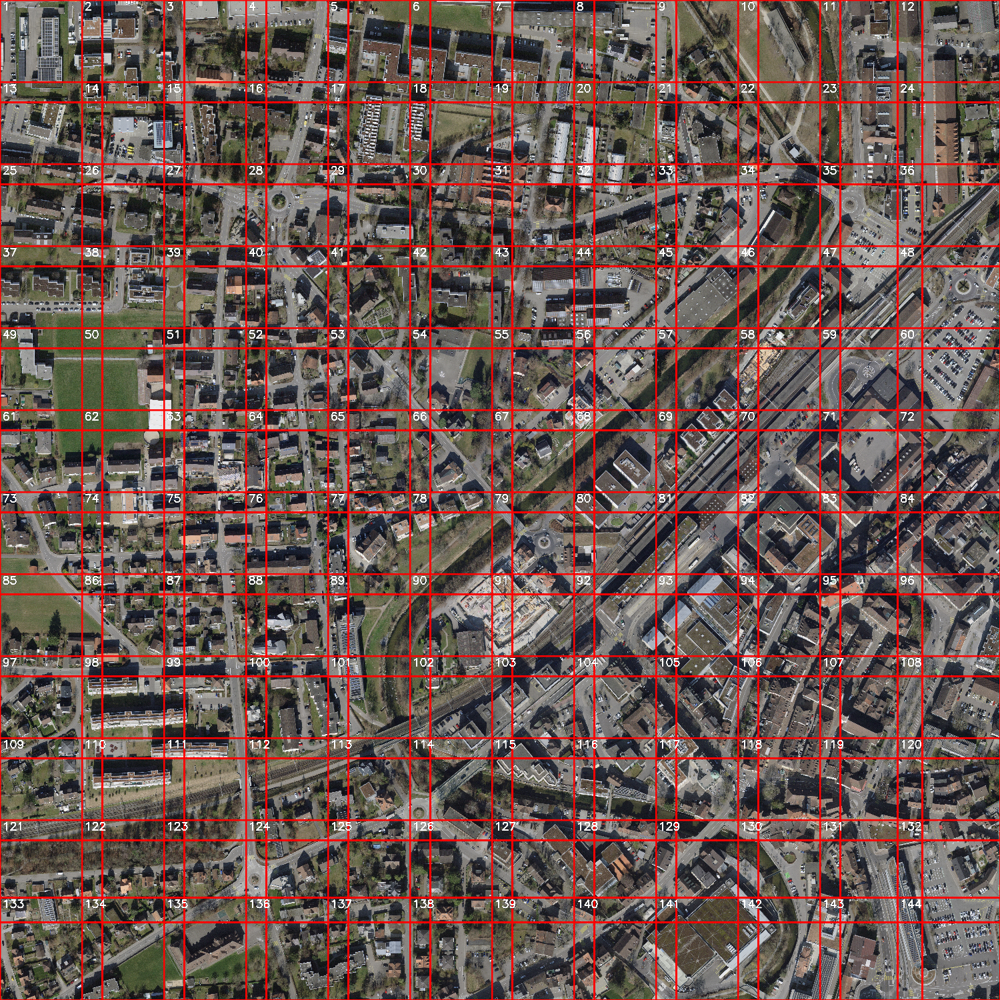

In [31]:
# Bild laden (RGB)
image = read_image(img_path)

# RGB → BGR (für OpenCV)
image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

vis_img = image_bgr.copy()

LINE_THICKNESS = 18
FONT = cv2.FONT_HERSHEY_SIMPLEX
FONT_SCALE = 3.6       # Schriftgröße
FONT_THICKNESS = 12

for idx, sp in enumerate(slice_result.starting_pixels, start=1):
    x = int(sp[0])
    y = int(sp[1])

    x1, y1 = x, y
    x2 = int(min(x + 1024, image.shape[1]))
    y2 = int(min(y + 1024, image.shape[0]))

    # Rechteck zeichnen
    cv2.rectangle(
        vis_img,
        (x1, y1),
        (x2, y2),
        (0, 0, 255),   # Rot (BGR)
        LINE_THICKNESS
    )

    # Textposition (leicht nach innen versetzt)
    text = str(idx)
    text_x = x1 + 25
    text_y = y1 + 100

    # Schwarzer Rand (Outline)
    cv2.putText(
        vis_img,
        text,
        (text_x, text_y),
        FONT,
        FONT_SCALE,
        (0, 0, 0),
        FONT_THICKNESS + 2,
        cv2.LINE_AA
    )

    # Weißer Text
    cv2.putText(
        vis_img,
        text,
        (text_x, text_y),
        FONT,
        FONT_SCALE,
        (255, 255, 255),
        FONT_THICKNESS,
        cv2.LINE_AA
    )

# Vorschau verkleinern
h, w = vis_img.shape[:2]
vis_small = cv2.resize(vis_img, (int(w * 0.15), int(h * 0.15)))

cv2_imshow(vis_small)


# Datenakquisition & Preprocessing
**Erstellung des YOLO-Datensatzes**

Wir konvertieren die Geo-Daten (Shapefiles) in das **YOLO-Format** (normalisierte Center-Koordinaten und Bounding Box Grössen). Da Luftbilder oft unterschiedliche Koordinatensysteme haben, führen wir eine **CRS-Transformation** (Coordinate Reference System) durch.

## Trainingsdaten Kreisel

In [ ]:
import os
import glob
import geopandas as gpd
import rasterio
from PIL import Image
from tqdm import tqdm
from shapely.geometry import box
import numpy as np

# Limits für extrem große Luftbilder aufheben
Image.MAX_IMAGE_PIXELS = None

# Pfade definieren (Absolut für Google Colab/Drive)
input_tiles = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_Kreisel_Training"
shp_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/gdf_kreisel.shp"
yolo_root = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset"

image_dir = os.path.abspath(os.path.join(yolo_root, "images"))
label_dir = os.path.abspath(os.path.join(yolo_root, "labels"))

os.makedirs(image_dir, exist_ok=True)
os.makedirs(label_dir, exist_ok=True)

# --- 2. DATEN LADEN ---
print("🛰️ Lade Shapefile...")
gdf = gpd.read_file(shp_path)

if gdf.crs is None:
    print("⚠️ Kein CRS im Shapefile gefunden. Setze EPSG:2056 (LV95)...")
    gdf.set_crs(epsg=2056, inplace=True)

tif_files = glob.glob(os.path.join(input_tiles, "*.tif"))
print(f"✅ Gefunden: {len(tif_files)} TIF-Dateien.")

# --- 3. VERARBEITUNG ---
crs_initialized = False

for tif_path in tqdm(tif_files, desc="Gesamtfortschritt"):
    file_name = os.path.basename(tif_path)
    base_name = os.path.splitext(file_name)[0]

    target_img_path = os.path.join(image_dir, f"{base_name}.jpg")
    label_path = os.path.join(label_dir, f"{base_name}.txt")

    # Skip falls Datei bereits existiert (spart Zeit bei Neustart)
    if os.path.exists(target_img_path):
        continue

    try:
        with rasterio.open(tif_path) as src:
            # CRS einmalig abgleichen
            if not crs_initialized:
                if gdf.crs != src.crs:
                    print(f"🔄 Transformiere Shapefile nach {src.crs}...")
                    gdf = gdf.to_crs(src.crs)
                crs_initialized = True

            img_bounds = src.bounds
            tile_geom = box(*img_bounds)

            # Prüfen, welche Kreisel im aktuellen Bild liegen
            possible_matches_index = gdf.sindex.query(tile_geom, predicate="intersects")
            intersecting_gdf = gdf.iloc[possible_matches_index]

            if intersecting_gdf.empty:
                continue

            img_width, img_height = src.width, src.height
            yolo_annotations = []

            for _, row in intersecting_gdf.iterrows():
                # Geometrie-Bounds (Puffer von 15m für Kontext)
                minx, miny, maxx, maxy = row.geometry.bounds
                minx, miny, maxx, maxy = minx-15, miny-15, maxx+15, maxy+15

                # Weltkoordinaten in Pixel umrechnen
                top_left = src.index(minx, maxy)
                bottom_right = src.index(maxx, miny)

                px_x_min, px_y_min = top_left[1], top_left[0]
                px_x_max, px_y_max = bottom_right[1], bottom_right[0]

                # Clipping auf Bildränder
                px_x_min = max(0, min(img_width, px_x_min))
                px_x_max = max(0, min(img_width, px_x_max))
                px_y_min = max(0, min(img_height, px_y_min))
                px_y_max = max(0, min(img_height, px_y_max))

                bw_px, bh_px = px_x_max - px_x_min, px_y_max - px_y_min

                # YOLO Format berechnen (normalisiert 0-1)
                if bw_px > 5 and bh_px > 5:
                    x_center = (px_x_min + bw_px / 2) / img_width
                    y_center = (px_y_min + bh_px / 2) / img_height
                    w_norm, h_norm = bw_px / img_width, bh_px / img_height
                    yolo_annotations.append(f"0 {x_center:.6f} {y_center:.6f} {w_norm:.6f} {h_norm:.6f}")

            # Bilder und Labels speichern
            if yolo_annotations:
                # Bild konvertieren und speichern
                with Image.open(tif_path) as img:
                    img.convert('RGB').save(target_img_path, "JPEG", quality=95)

                # Label-Textdatei schreiben
                with open(label_path, "w") as f:
                    f.write("\n".join(yolo_annotations) + "\n")

    except Exception as e:
        print(f"⚠️ Fehler bei {file_name}: {e}")

print(f"\n✅ Teil 1 abgeschlossen! Daten unter: {yolo_root}")

## Darstellung

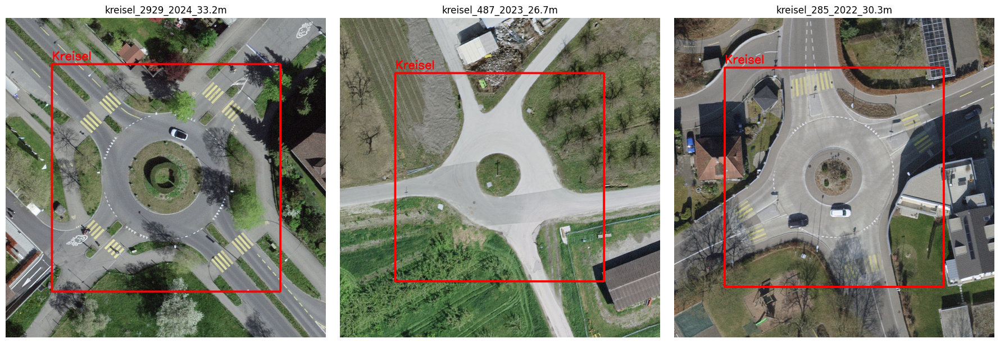

In [3]:
import os
import cv2
import matplotlib.pyplot as plt
import glob
import random

yolo_root = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset"
images_path = os.path.join(yolo_root, "images")
labels_path = os.path.join(yolo_root, "labels")

# Alle Bilder finden, die bereits generiert wurden
available_images = glob.glob(os.path.join(images_path, "*.jpg"))

if len(available_images) < 1:
    print("Noch keine Bilder fertig. Warte noch einen Moment...")
else:
    # 3 zufällige Bilder auswählen (oder weniger, falls noch nicht genug da sind)
    num_samples = min(3, len(available_images))
    sample_imgs = random.sample(available_images, num_samples)

    fig, axes = plt.subplots(1, num_samples, figsize=(18, 6))
    if num_samples == 1: axes = [axes]

    for i, img_path in enumerate(sample_imgs):
        # Bild laden
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        # Passendes Label finden
        base_name = os.path.splitext(os.path.basename(img_path))[0]
        label_file = os.path.join(labels_path, f"{base_name}.txt")

        if os.path.exists(label_file):
            with open(label_file, "r") as f:
                for line in f:
                    # YOLO Format: class x_center y_center width height
                    cls, x_c, y_c, bw, bh = map(float, line.split())

                    # Zurück in Pixel-Koordinaten rechnen
                    x1 = int((x_c - bw/2) * w)
                    y1 = int((y_c - bh/2) * h)
                    x2 = int((x_c + bw/2) * w)
                    y2 = int((y_c + bh/2) * h)

                    # Box zeichnen
                    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 3)
                    cv2.putText(img, "Kreisel", (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

        axes[i].imshow(img)
        axes[i].set_title(base_name)
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# 3. Methodik

**Systematik**

Wir setzen auf **YOLO** (You Only Look Once), da es ein effizienter Single-Shot-Detector ist, der Merkmale und Lokalisierung in einem Durchgang lernt.

**Die Herausforderung**: Luftbilder sind oft 10'000x10'000 Pixel gross. Ein Standard-Modell würde die kleinen Kreisel darin "übersehen". Die Lösung: 1. Hintergrund-Sampling: Wir generieren gezielt 500 Kacheln ohne Kreisel, um "False Positives" (z.B. runde Gebäude) zu minimieren. 2. SAHI: Während der Inference wird das Bild in Slices unterteilt, was die Detektionsrate bei kleinen Objekten massiv erhöht.

## Integration von Hintergrundbildern (Negativ-Beispiele)
Um die **False-Positive-Rate** zu senken, generieren wir gezielt Hintergrundkacheln, die keine Kreisel enthalten. Dies zwingt das Modell, Merkmale wie normale Strassenkreuzungen von Kreiseln zu unterscheiden.


Teil 2: Hintergrundbilder hinzufügen (Negative Training)

📊 0 Hintergrund-Kacheln bereits vorhanden.
🚀 Suche weitere 500 Kacheln...


Suche:   1%|          | 20/2279 [01:11<2:14:17,  3.57s/it]



🔍 Vorschau der Hintergrund-Kacheln:


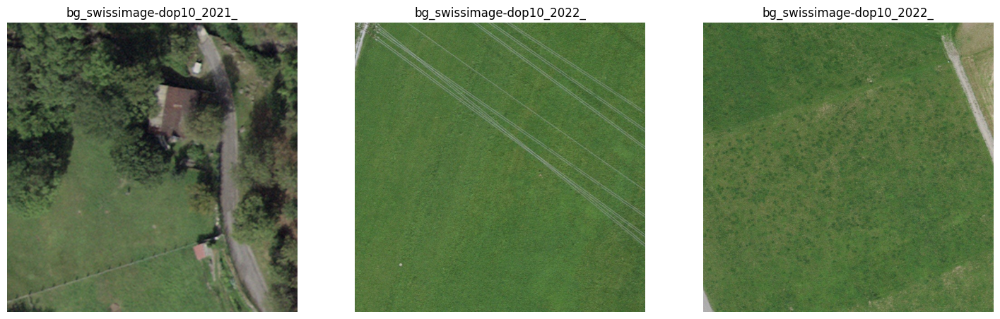

In [ ]:
import os
import glob
import geopandas as gpd
import rasterio
from rasterio.windows import Window
from PIL import Image
from tqdm import tqdm
from shapely.geometry import box
import random
import cv2
import matplotlib.pyplot as plt

# --- 1. KONFIGURATION ---
input_tiles = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m"
shp_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/gdf_kreisel.shp"
yolo_root = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset"

TILE_SIZE = 750
MAX_TOTAL_SAMPLES = 500
MAX_PER_TIF = 25

Image.MAX_IMAGE_PIXELS = None
image_dir = os.path.join(yolo_root, "images")
label_dir = os.path.join(yolo_root, "labels")
os.makedirs(image_dir, exist_ok=True)
os.makedirs(label_dir, exist_ok=True)

# --- 2. CHECK VORHANDENER DATEN ---
# Wir zählen nur die Hintergrundbilder, um zu wissen, wie viele noch fehlen
existing_bg_files = glob.glob(os.path.join(image_dir, "bg_*.jpg"))
total_count = len(existing_bg_files)
print(f"📊 {total_count} Hintergrund-Kacheln bereits vorhanden.")

# --- 3. HINTERGRUND-KACHELN GENERIEREN ---
if total_count >= MAX_TOTAL_SAMPLES:
    print("✅ Zielanzahl von 500 Kacheln bereits erreicht. Springe direkt zur Visualisierung.")
else:
    gdf = gpd.read_file(shp_path)
    if gdf.crs is None: gdf.set_crs(epsg=2056, inplace=True)

    tif_files = glob.glob(os.path.join(input_tiles, "*.tif"))
    random.shuffle(tif_files)

    crs_transformed = False

    print(f"🚀 Suche weitere {MAX_TOTAL_SAMPLES - total_count} Kacheln...")

    for tif_path in tqdm(tif_files, desc="Suche"):
        if total_count >= MAX_TOTAL_SAMPLES: break

        try:
            # Wir öffnen das File nur kurz für die Metadaten (Bounds/CRS)
            with rasterio.open(tif_path) as src:
                if not crs_transformed:
                    if gdf.crs != src.crs: gdf = gdf.to_crs(src.crs)
                    crs_transformed = True

                possible_windows = [(x, y) for y in range(0, src.height - TILE_SIZE, TILE_SIZE)
                                           for x in range(0, src.width - TILE_SIZE, TILE_SIZE)]
                random.shuffle(possible_windows)

                samples_from_this_tif = 0
                for x, y in possible_windows:
                    if samples_from_this_tif >= MAX_PER_TIF or total_count >= MAX_TOTAL_SAMPLES: break

                    file_id = f"bg_{os.path.basename(tif_path).split('.')[0]}_{x}_{y}"
                    target_img_path = os.path.join(image_dir, f"{file_id}.jpg")

                    # --- DER SKIP-CHECK ---
                    # Wenn das Bild existiert, laden wir weder das Pixel-Array noch berechnen wir Geometrien
                    if os.path.exists(target_img_path):
                        continue

                    # Erst jetzt berechnen wir die Geometrie für neue Kacheln
                    window = Window(x, y, TILE_SIZE, TILE_SIZE)
                    window_geom = box(*src.window_bounds(window))
                    hits = gdf.sindex.query(window_geom, predicate="intersects")

                    if len(hits) == 0:
                        # Erst hier werden tatsächlich Pixel von der Festplatte gelesen
                        data = src.read(window=window)
                        img_data = data[:3, :, :].transpose(1, 2, 0)

                        Image.fromarray(img_data).save(target_img_path, "JPEG", quality=90)
                        with open(os.path.join(label_dir, f"{file_id}.txt"), "w") as f: pass

                        samples_from_this_tif += 1
                        total_count += 1

        except Exception as e:
            print(f"⚠️ Fehler bei {os.path.basename(tif_path)}: {e}")

# --- 4. VISUALISIERUNG ---
print("\n🔍 Vorschau der Hintergrund-Kacheln:")
bg_samples = glob.glob(os.path.join(image_dir, "bg_*.jpg"))

if bg_samples:
    num_samples = min(3, len(bg_samples))
    sample_imgs = random.sample(bg_samples, num_samples)
    fig, axes = plt.subplots(1, num_samples, figsize=(18, 6))
    if num_samples == 1: axes = [axes]

    for i, img_path in enumerate(sample_imgs):
        img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
        axes[i].imshow(img)
        axes[i].set_title(os.path.basename(img_path)[:25])
        axes[i].axis('off')
    plt.show()

## Darstellung

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import glob
import random

yolo_root = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset"
images_path = os.path.join(yolo_root, "images")
labels_path = os.path.join(yolo_root, "labels")

# Alle Bilder finden, die bereits generiert wurden
available_images = glob.glob(os.path.join(images_path, "*.jpg"))

if len(available_images) < 1:
    print("Noch keine Bilder fertig. Warte noch einen Moment...")
else:
    # 3 zufällige Bilder auswählen (oder weniger, falls noch nicht genug da sind)
    num_samples = min(3, len(available_images))
    sample_imgs = random.sample(available_images, num_samples)

    fig, axes = plt.subplots(1, num_samples, figsize=(18, 6))
    if num_samples == 1: axes = [axes]

    for i, img_path in enumerate(sample_imgs):
        # Bild laden
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        # Passendes Label finden
        base_name = os.path.splitext(os.path.basename(img_path))[0]
        label_file = os.path.join(labels_path, f"{base_name}.txt")

        if os.path.exists(label_file):
            with open(label_file, "r") as f:
                for line in f:
                    # YOLO Format: class x_center y_center width height
                    cls, x_c, y_c, bw, bh = map(float, line.split())

                    # Zurück in Pixel-Koordinaten rechnen
                    x1 = int((x_c - bw/2) * w)
                    y1 = int((y_c - bh/2) * h)
                    x2 = int((x_c + bw/2) * w)
                    y2 = int((y_c + bh/2) * h)

                    # Box zeichnen
                    cv2.rectangle(img, (x1, y1), (x2, y2), (255, 0, 0), 3)
                    cv2.putText(img, "Kreisel", (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

        axes[i].imshow(img)
        axes[i].set_title(base_name)
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

## Trainingssplit
Wir verwenden ein **YOLO** (You Only Look Once) Modell. Diese Architektur gehört zur Gruppe der **Single-Shot-Detector** und ist ideal für Echtzeit-Objekterkennung.

**Trainings-Konfiguration**


*   Split: 80% Training, 20% Validierung.
*   Augmentation: Zufälliges Shuffling der Kacheln zur Erhöhung der Generalisierungsfähigkeit.





In [ ]:
import os
import random
import shutil

# Pfade
yolo_root = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset"
images_path = os.path.join(yolo_root, "images")
labels_path = os.path.join(yolo_root, "labels")

# 1. PRÜFEN: Sind die Quellordner überhaupt da?
if not os.path.exists(images_path):
    print(f"⚠️ Quellordner nicht gefunden: {images_path}")
    print("Vermutlich wurden die Dateien bereits erfolgreich in 'train' und 'val' verschoben.")
else:
    # Neue Ordnerstruktur erstellen
    for split in ['train', 'val']:
        os.makedirs(os.path.join(yolo_root, split, 'images'), exist_ok=True)
        os.makedirs(os.path.join(yolo_root, split, 'labels'), exist_ok=True)

    # Alle Bilder auflisten
    all_images = [f for f in os.listdir(images_path) if f.lower().endswith('.jpg')]
    random.shuffle(all_images)

    if len(all_images) > 0:
        split_idx = int(len(all_images) * 0.8)
        train_imgs = all_images[:split_idx]
        val_imgs = all_images[split_idx:]

        def move_files(img_list, target_split):
            count = 0
            for img_name in img_list:
                src_img = os.path.join(images_path, img_name)
                dst_img = os.path.join(yolo_root, target_split, 'images', img_name)

                label_name = os.path.splitext(img_name)[0] + '.txt'
                src_label = os.path.join(labels_path, label_name)
                dst_label = os.path.join(yolo_root, target_split, 'labels', label_name)

                shutil.move(src_img, dst_img)
                if os.path.exists(src_label):
                    shutil.move(src_label, dst_label)
                else:
                    with open(dst_label, 'w') as f: pass # Leeres Label für Background
                count += 1
            return count

        print("🚚 Verschiebe Dateien...")
        n_train = move_files(train_imgs, 'train')
        n_val = move_files(val_imgs, 'val')

        print("🧹 Bereinigung...")
        shutil.rmtree(images_path, ignore_errors=True)
        shutil.rmtree(labels_path, ignore_errors=True)
        print(f"✅ Split fertig! {n_train} in train, {n_val} in val.")
    else:
        print("Empty directory: Keine Bilder zum Verschieben gefunden.")

# --- 2. ERSTELLUNG DER DATA.YAML ---
yaml_content = f"""
train: {yolo_root}/train/images
val: {yolo_root}/val/images

nc: 1
names: ['Kreisel']
"""

with open(os.path.join(yolo_root, 'data.yaml'), 'w') as f:
    f.write(yaml_content)

print(f"📄 data.yaml wurde erstellt unter: {os.path.join(yolo_root, 'data.yaml')}")

🚚 Verschiebe Dateien...
🧹 Bereinigung...
✅ Split fertig! 448 in train, 112 in val.
📄 data.yaml wurde erstellt unter: /content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/data.yaml


# 4. Training & Validierung
Das Modell lernt nun, die visuellen Merkmale eines Kreisels (runde Form, Markierungen, Fahrbahnen) zu abstrahieren.

In [32]:
import os

train_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/train/images"
val_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/val/images"

num_train = len(os.listdir(train_path))
num_val = len(os.listdir(val_path))

print(f"Anzahl Trainingsbilder: {num_train}")
print(f"Anzahl Validierungsbilder: {num_val}")


Anzahl Trainingsbilder: 2824
Anzahl Validierungsbilder: 706


In [ ]:
from ultralytics import YOLO
import torch

# Prüfen, ob GPU verfügbar ist, sonst CPU nutzen
device_to_use = 0 if torch.cuda.is_available() else 'cpu'
print(f"🚀 Training läuft auf: {device_to_use}")

# Lade das Modell
model = YOLO("yolo11n.pt")

# Training starten
results = model.train(
    data='/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/data.yaml',
    epochs=100,
    imgsz=750,
    batch=32,           # Bei einer A100 kannst du sogar auf 32 oder 64 gehen
    degrees=180.0,
    flipud=0.5,
    fliplr=0.5,
    mosaic=1.0,
    patience=20,
    name='kreisel_final_v4',
    device=device_to_use  # Nutzt automatisch GPU falls vorhanden
)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
🚀 Training läuft auf: 0
Ultralytics 8.3.240 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (NVIDIA A100-SXM4-80GB, 81222MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/data.yaml, degrees=180.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.5, format=torchscript, fraction=1.0, freeze=None, half=False, 

RuntimeError: Dataset '/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/data.yaml' error ❌ '/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/data.yaml' does not exist

2. Alles sichern (Modell & Statistiken)

In [ ]:
import shutil
import os

# Pfade definieren
source_run = '/content/runs/detect/kreisel_final_v4'
drive_dest = '/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4'

# In Drive sichern
if os.path.exists(source_run):
    shutil.copytree(source_run, drive_dest, dirs_exist_ok=True)
    print(f"✅ Alle Ergebnisse und das Modell wurden gesichert: {drive_dest}")

# Evaluation & Resultate

Nach dem Training validieren wir das Modell anhand der Metriken, die während des Prozesses in den runs/ Ordner geschrieben wurden.

3. Visualisierung der Ergebnisse

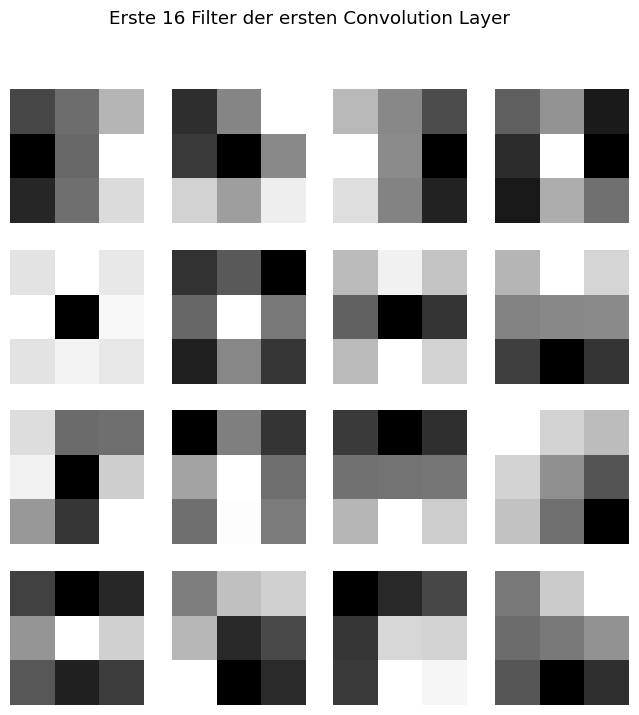

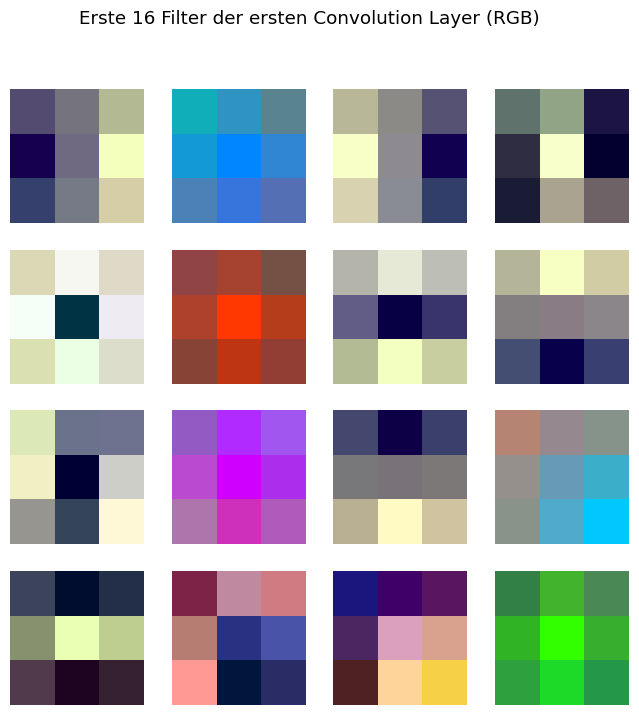

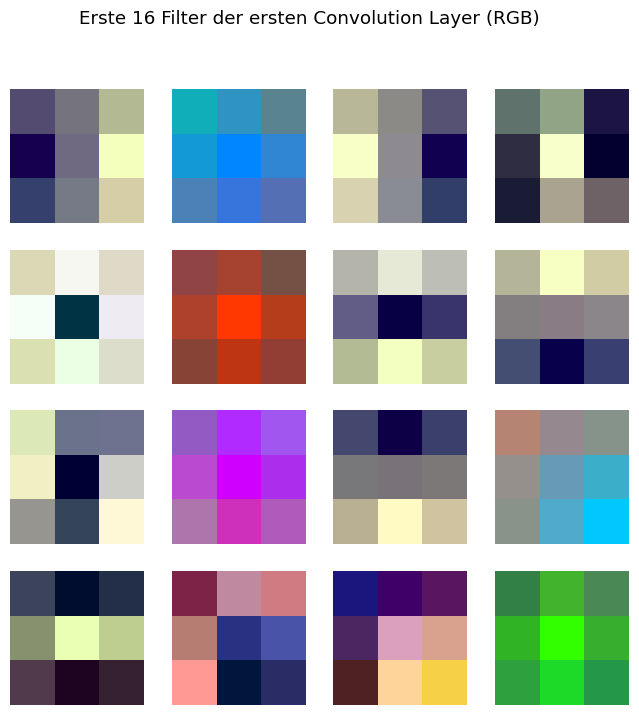

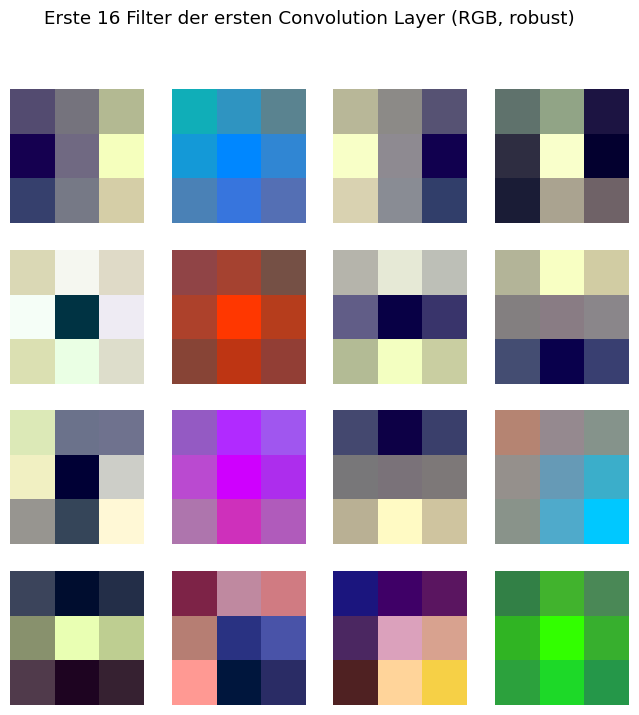

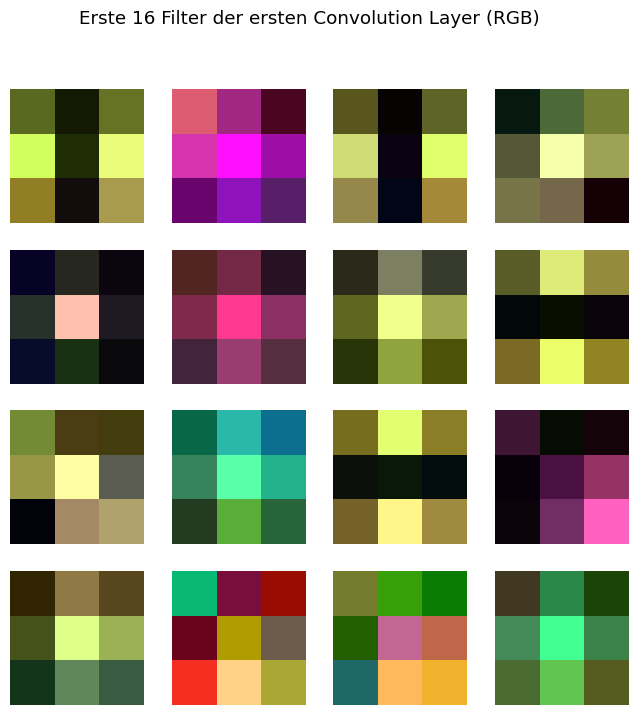

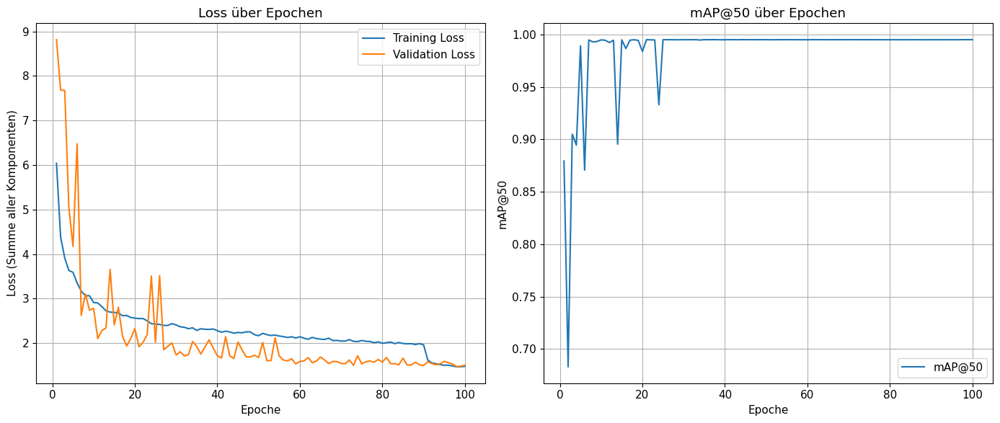

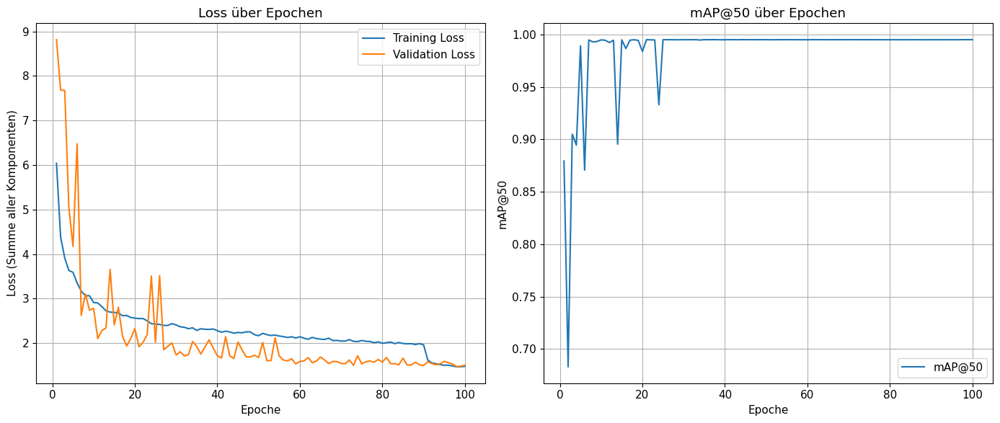

In [48]:
# 1️⃣ Matplotlib inline aktivieren (Colab)
%matplotlib inline

import pandas as pd
import matplotlib.pyplot as plt

# 2️⃣ CSV laden
csv_path = '/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4/results.csv'
df = pd.read_csv(csv_path)

plt.figure(figsize=(14, 6))

# 3️⃣ Loss über Epochen (Training + Validation)
plt.subplot(1, 2, 1)
train_loss = df['train/box_loss'] + df['train/cls_loss'] + df['train/dfl_loss']
val_loss = df['val/box_loss'] + df['val/cls_loss'] + df['val/dfl_loss']

plt.plot(df['epoch'], train_loss, label='Training Loss')
plt.plot(df['epoch'], val_loss, label='Validation Loss')
plt.title('Loss über Epochen')
plt.xlabel('Epoche')
plt.ylabel('Loss (Summe aller Komponenten)')
plt.legend()
plt.grid(True)

# 4️⃣ Metrik über Epochen (mAP@50)
plt.subplot(1, 2, 2)
plt.plot(df['epoch'], df['metrics/mAP50(B)'], label='mAP@50')
plt.title('mAP@50 über Epochen')
plt.xlabel('Epoche')
plt.ylabel('mAP@50')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


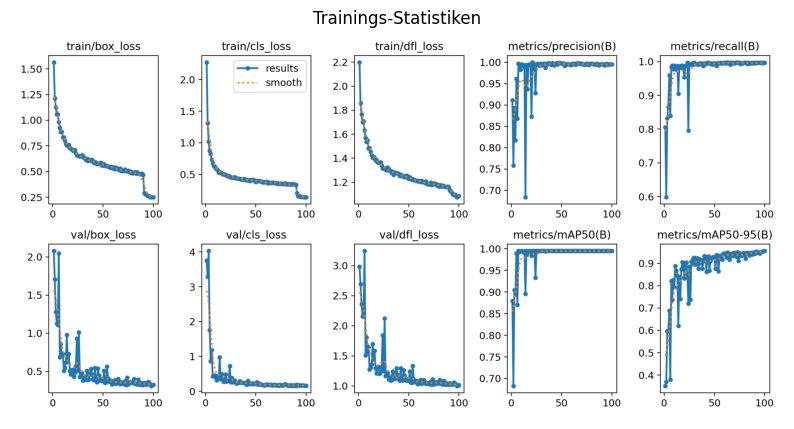

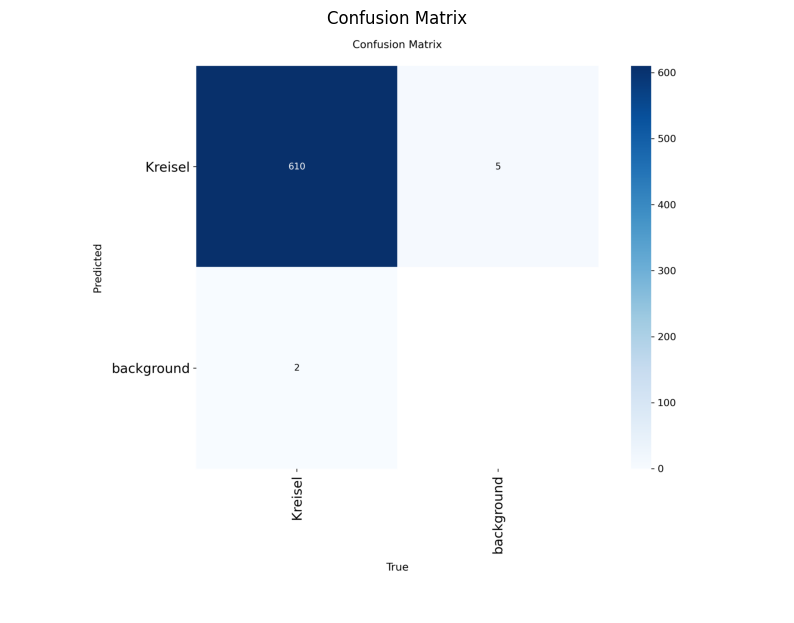

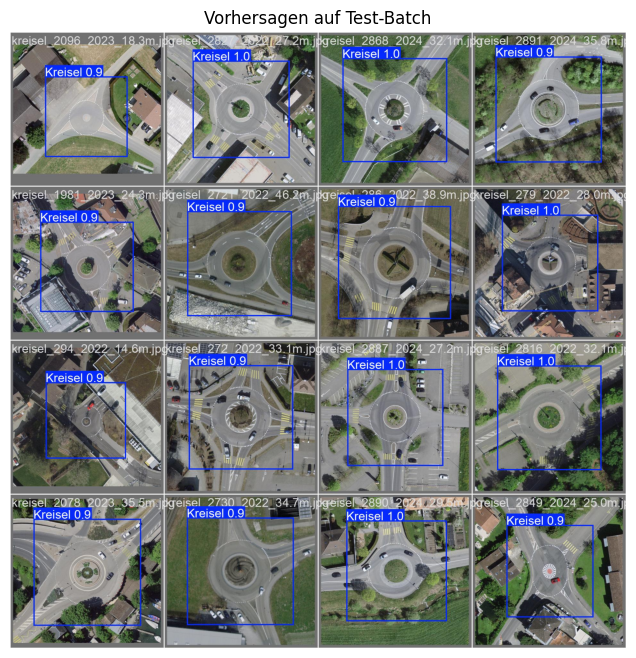

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_yolo_result(file_name, title):
    path = f'/content/runs/detect/kreisel_final_v4/{file_name}'
    if os.path.exists(path):
        plt.figure(figsize=(10, 8))
        img = mpimg.imread(path)
        plt.imshow(img)
        plt.title(title)
        plt.axis('off')
        plt.show()

# Zeige wichtige Diagramme
plot_yolo_result('results.png', 'Trainings-Statistiken')
plot_yolo_result('confusion_matrix.png', 'Confusion Matrix')
plot_yolo_result('val_batch0_pred.jpg', 'Vorhersagen auf Test-Batch')

3. Test auf einem neuen Bild (Hintergrund Luftbild)

## Test von Modell mit Fine-Tuning

✅ Datei gefunden: /content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m/swissimage-dop10_2022_2709-1268_0.1_2056.tif
Performing prediction on 144 slices.
🔍 Gefunden insgesamt: 13
✅ Davon mit Confidence >= 0.8: 11
🖼️ Zeige verkleinerte Vorschau (nur High-Confidence):


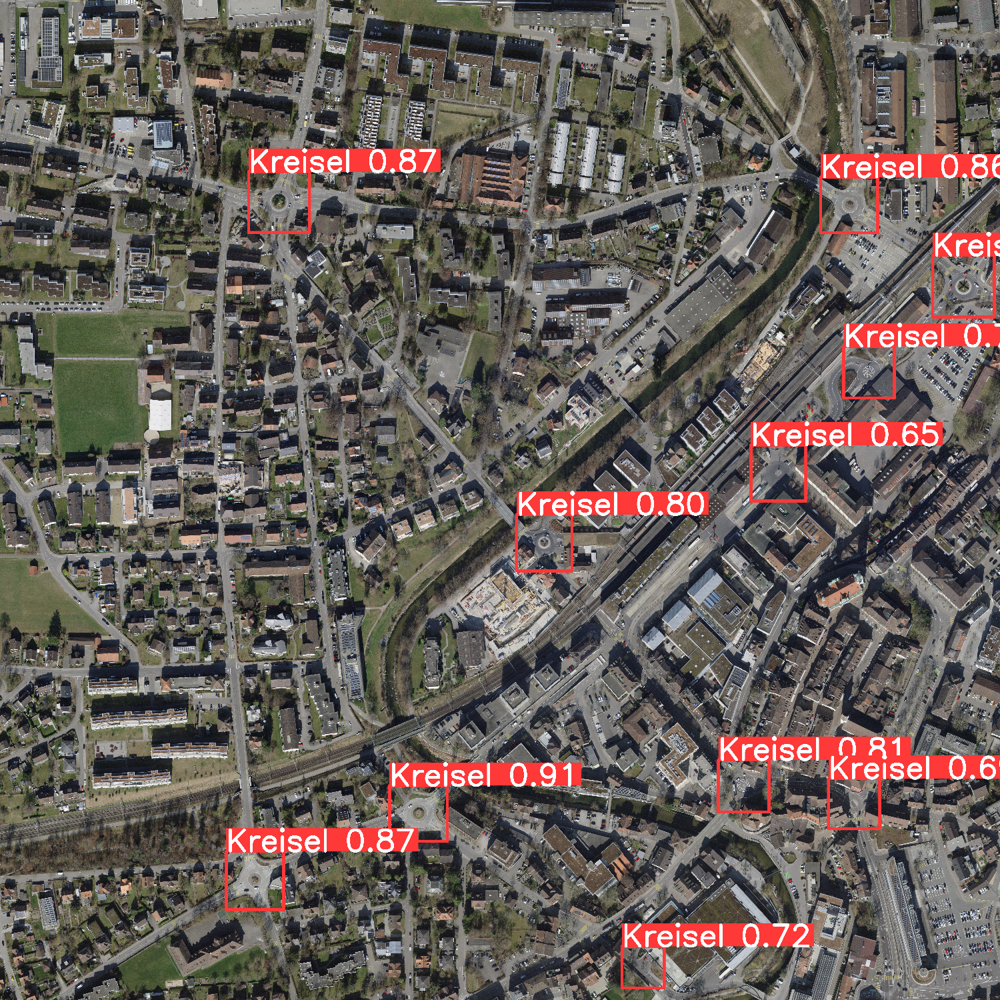

In [ ]:
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from sahi.utils.cv import visualize_object_predictions, read_image
import cv2
import os
from google.colab.patches import cv2_imshow

# --- 1. KONFIGURATION ---
# Achte darauf, dass am Ende des Pfades kein Kommentar-Text steht, der den String stören könnte
model_path = '/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4/weights/best.pt'
img_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m/swissimage-dop10_2022_2709-1268_0.1_2056.tif"  #swissimage-dop10_2024_2605-1196_0.1_2056.tif   #sursee swissimage-dop10_2024_2650-1225_0.1_2056.tif   11 kreisel swissimage-dop10_2022_2709-1268_0.1_2056.tif

# --- 2. MODELL LADEN ---
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=model_path,
    confidence_threshold=0.5,
    device="cuda", # Nutze "cpu", falls keine GPU aktiv ist
)

# --- 3. BILD LADEN & PRÜFEN ---
if os.path.exists(img_path):
    print(f"✅ Datei gefunden: {img_path}")

    # Bild einlesen
    image = read_image(img_path)

    # --- AB HIER: ALLES MUSS EINGERÜCKT SEIN (Teil des if-Blocks) ---

    # 3. Sliced Prediction ausführen
    result = get_sliced_prediction(
        image,
        detection_model,
        slice_height=1024,
        slice_width=1024,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2
    )

    # 4. Filtern der Ergebnisse auf 0.8 Confidence
    filtered_predictions = [
        pred for pred in result.object_prediction_list
        if pred.score.value >= 0.63
    ]

    # Statistiken ausgeben
    print(f"🔍 Gefunden insgesamt: {len(result.object_prediction_list)}")
    print(f"✅ Davon mit Confidence >= 0.8: {len(filtered_predictions)}")

    # 5. Visualisierung (mit gefilterter Liste)
    visualization_result = visualize_object_predictions(
        image=image,
        object_prediction_list=filtered_predictions,
    )

    # Bild für die Anzeige vorbereiten
    output_img = visualization_result["image"]
    # Konvertierung von RGB (SAHI) zu BGR (OpenCV)
    output_img_bgr = cv2.cvtColor(output_img, cv2.COLOR_RGB2BGR)

    # Bild verkleinern für die Vorschau in Colab (15% der Originalgröße)
    h, w = output_img_bgr.shape[:2]
    small_img = cv2.resize(output_img_bgr, (int(w * 0.15), int(h * 0.15)))

    print("🖼️ Zeige verkleinerte Vorschau (nur High-Confidence):")
    cv2_imshow(small_img)

else:
    # Falls der Pfad falsch ist, wird dies ausgegeben statt eines NameErrors
    print(f"❌ FEHLER: Die Datei konnte unter folgendem Pfad nicht gefunden werden:")
    print(f"   {img_path}")
    print("👉 Bitte prüfe, ob Google Drive korrekt gemountet ist und der Dateiname stimmt.")

# 5. Inference & Skalierung (Massenanalyse)
Hier wenden wir das Modell auf neue, unbekannte Daten an. Die Besonderheit: Wir transformieren die Pixel-Koordinaten zurück in Schweizer Landeskoordinaten (LV95).

In diesem letzten Schritt führen wir eine Massen-Analyse (Inference) über eine Stichprobe von 100-43'000 Kacheln durch. Die Pixel-Koordinaten der erkannten Kreisel werden mathematisch zurück in das Schweizer Landeskoordinatensystem LV95 transformiert.

**Koordinatentransformation (Formel)**

Die Umrechnung erfolgt linear basierend auf dem Ursprung der Kachel ($E_{min}, N_{max}$) und der Pixelauflösung (0.1m):

$$E = E_{min} + (px_x \cdot 0.1)$$$$N = N_{max} - (px_y \cdot 0.1)$$

## Test (100) Kacheln

In [ ]:
import os
import pandas as pd
import re
import requests
import rasterio
from rasterio.enums import Resampling
import cv2
import numpy as np
from tqdm import tqdm
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from ultralytics import YOLO
import folium
from folium.plugins import MarkerCluster

# --- 1. KONFIGURATION & PFADE ---
csv_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/ch.swisstopo.swissimage-dop10-lhM7Ju9P_CH.csv"
model_weights = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4/weights/best.pt"
image_dir = "/content/temp_images/"
output_csv = "/content/drive/MyDrive/Colab Notebooks/Bsc/stichprobe_ergebnisse_v4.csv"
CONF_FILTER = 0.74  # Nur Ergebnisse >= 0.8 werden gespeichert/angezeigt

os.makedirs(image_dir, exist_ok=True)

# --- 2. MODELLE & DATEN LADEN ---
print("🚀 Lade YOLO11-Modell (v4) und SAHI Engine...")
native_model = YOLO(model_weights)
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8", # Nutzt intern die YOLO-Struktur für SAHI
    model_path=model_weights,
    confidence_threshold=0.74, # Grobfilter für die Slicing-Stufe
    device="cuda",
)

# CSV mit den 30'000 URLs laden
df_urls = pd.read_csv(csv_path, header=None, names=["url"])
# Stichprobe ziehen (n=100 für den Test)
df_sample = df_urls.sample(n=100, random_state=41)

def pixel_to_lv95(tile_name, px_x, px_y):
    """Rechnet Pixel-Koordinaten in Schweizer Landeskoordinaten um."""
    match = re.search(r'_(\d{4})-(\d{4})_', tile_name)
    if match:
        e_min = int(match.group(1)) * 1000
        n_max = (int(match.group(2)) * 1000) + 1000
        # 0.1m Auflösung bei SwissImage: 1 Pixel = 0.1 Meter
        return e_min + (px_x * 0.1), n_max - (px_y * 0.1)
    return None, None

def lv95_to_wgs84(e, n):
    """Approximation von LV95 zu Breitengrad/Längengrad für die Karte."""
    x = (e - 2600000) / 1000000
    y = (n - 1200000) / 1000000
    lon = 7.43958 + 13.48446 * x
    lat = 46.95108 + 9.11626 * y + 1.2222 * x * y
    return lat, lon

# --- 3. ANALYSE-SCHLEIFE ---
results_list = []
processed_tiles = []
print(f"🎲 Starte Analyse von {len(df_sample)} Kacheln (Filter: Conf >= {CONF_FILTER})...")

for url in tqdm(df_sample["url"], desc="Fortschritt"):
    filename = url.split("/")[-1]
    img_path = os.path.join(image_dir, filename)

    try:
        # Download der Kachel
        r = requests.get(url, timeout=15)
        with open(img_path, "wb") as f:
            f.write(r.content)

        processed_tiles.append(filename)

        # STUFE 1: Nano-Scan (Thumbnail) für Geschwindigkeit
        with rasterio.open(img_path) as src:
            # Schnelles Downsampling auf 1250x1250
            thumbnail = src.read(out_shape=(src.count, 1250, 1250), resampling=Resampling.bilinear)
            img_nano = np.transpose(thumbnail, (1, 2, 0))
            img_nano = cv2.cvtColor(img_nano, cv2.COLOR_RGB2BGR)

        quick_results = native_model.predict(img_nano, conf=0.25, imgsz=1280, verbose=False)

        # STUFE 2: SAHI Full-Resolution (nur wenn Nano-Scan etwas vermutet)
        if len(quick_results[0].boxes) > 0:
            img_full = cv2.imread(img_path)
            img_full = cv2.cvtColor(img_full, cv2.COLOR_BGR2RGB)

            result = get_sliced_prediction(
                img_full,
                detection_model,
                slice_height=1024,
                slice_width=1024,
                overlap_height_ratio=0.2,
                overlap_width_ratio=0.2,
                verbose=0
            )

            for pred in result.object_prediction_list:
                conf = pred.score.value

                # --- CONFIDENCE FILTER ---
                if conf >= CONF_FILTER:
                    bbox = pred.bbox.to_xyxy()
                    cx, cy = (bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2
                    east, north = pixel_to_lv95(filename, cx, cy)

                    if east:
                        results_list.append({
                            "tile_name": filename,
                            "confidence": conf,
                            "LV95_E": east,
                            "LV95_N": north
                        })

        # Bild lokal löschen um Speicherplatz zu sparen
        if os.path.exists(img_path): os.remove(img_path)

    except Exception as e:
        if os.path.exists(img_path): os.remove(img_path)
        print(f"⚠️ Fehler bei Kachel {filename}: {e}")

# --- 4. AUSWERTUNG & LOGGING ---
print("\n" + "="*40)
print("📊 ÜBERSICHT DER GEPRÜFTEN KACHELN")
print("="*40)
for tile in processed_tiles:
    found_in_tile = [r for r in results_list if r['tile_name'] == tile]
    status = f"✅ {len(found_in_tile)} Kreisel gefunden" if found_in_tile else "⚪ leer"
    print(f"{tile:50} | {status}")

# --- 5. EXPORT & VISUALISIERUNG ---
df_final = pd.DataFrame(results_list)

if not df_final.empty:
    # Dubletten entfernen (falls ein Kreisel in zwei Kacheln erkannt wurde)
    df_final = df_final.sort_values('confidence', ascending=False).drop_duplicates(subset=['LV95_E', 'LV95_N'])
    df_final.to_csv(output_csv, index=False)

    print(f"\n✅ Analyse beendet. {len(df_final)} Kreisel (>= {CONF_FILTER}) gespeichert unter:\n{output_csv}")

    # Interaktive Karte erstellen
    m = folium.Map(location=[46.8182, 8.2275], zoom_start=8, tiles='OpenStreetMap')
    marker_cluster = MarkerCluster().add_to(m)

    for _, row in df_final.iterrows():
        lat, lon = lv95_to_wgs84(row['LV95_E'], row['LV95_N'])
        folium.Marker(
            location=[lat, lon],
            popup=f"Kreisel (Confidence: {row['confidence']:.2f})<br>LV95: {row['LV95_E']:.1f}, {row['LV95_N']:.1f}",
            icon=folium.Icon(color='green', icon='info-sign')
        ).add_to(marker_cluster)

    display(m)
else:
    print(f"\n⚠️ In der Stichprobe von {len(df_sample)} Kacheln wurden keine Kreisel mit Confidence >= {CONF_FILTER} gefunden.")

🚀 Lade YOLO11-Modell (v4) und SAHI Engine...
🎲 Starte Analyse von 100 Kacheln (Filter: Conf >= 0.74)...


Fortschritt: 100%|██████████| 100/100 [09:03<00:00,  5.44s/it]


📊 ÜBERSICHT DER GEPRÜFTEN KACHELN
swissimage-dop10_2022_2737-1235_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2021_2719-1128_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2024_2655-1205_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2802-1180_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2733-1218_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2819-1198_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2023_2582-1181_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2021_2716-1090_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2023_2539-1207_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2024_2594-1223_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2716-1207_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2745-1198_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2023_2571-1233_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2022_2730-1261_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2023_2577-1255_0.1_2056.tif       | ⚪ leer
swissimage-dop10_2023_2556-1131_0.1_2056.tif       | ⚪ leer
swiss

# Interaktive Visualisierung

In [ ]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
from pyproj import Transformer

# --- PRÄZISE TRANSFORMATION ---
# LV95 (EPSG:2056) -> WGS84 (EPSG:4326)
# always_xy=True sorgt dafür, dass Easting/Northing korrekt als X/Y behandelt werden
transformer = Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)

def lv95_to_wgs84_precise(e, n):
    """Hochpräzise Umrechnung für die Schweiz."""
    lon, lat = transformer.transform(e, n)
    return lat, lon

# --- EXPORT ALS GEOJSON & SHAPEFILE ---
df_final = pd.DataFrame(results_list)

if not df_final.empty:
    # Dubletten entfernen
    df_final = df_final.sort_values('confidence', ascending=False).drop_duplicates(subset=['LV95_E', 'LV95_N'])

    # Geometrie-Objekte erstellen (Punkte aus LV95 Koordinaten)
    geometry = [Point(e, n) for e, n in zip(df_final['LV95_E'], df_final['LV95_N'])]

    # GeoDataFrame erstellen (Zuerst in LV95)
    gdf = gpd.GeoDataFrame(df_final, geometry=geometry, crs="EPSG:2056")

    # Export Pfade
    geojson_output = output_csv.replace(".csv", ".geojson")

    # In GeoJSON speichern (wird automatisch in WGS84 transformiert, falls gewünscht)
    gdf_wgs84 = gdf.to_crs("EPSG:4326")
    gdf_wgs84.to_file(geojson_output, driver='GeoJSON')

    print(f"\n✅ Präzise Daten gespeichert:")
    print(f"📍 CSV: {output_csv}")
    print(f"🌍 GeoJSON (für QGIS/ArcGIS): {geojson_output}")

    # --- VISUALISIERUNG AUF DER KARTE ---
    m = folium.Map(location=[46.8182, 8.2275], zoom_start=8, tiles=None)

    folium.TileLayer(
        tiles='https://wmts.geo.admin.ch/1.0.0/ch.swisstopo.swissimage/default/current/3857/{z}/{x}/{y}.jpeg',
        attr='&copy; swisstopo',
        name='swisstopo Orthophoto',
        overlay=False
    ).add_to(m)

    marker_cluster = MarkerCluster(name="Gefundene Kreisel").add_to(m)

    for _, row in gdf_wgs84.iterrows():
        # Da wir nun ein GeoDataFrame in WGS84 haben, nutzen wir direkt die Geometrie
        lat, lon = row.geometry.y, row.geometry.x
        folium.Marker(
            location=[lat, lon],
            popup=f"Confidence: {row['confidence']:.2f}<br>LV95 E: {row['LV95_E']:.2f}",
            icon=folium.Icon(color='green', icon='info-sign')
        ).add_to(marker_cluster)

    folium.LayerControl().add_to(m)
    display(m)

# Datensatz mit bestehenden Kreisel (2279 Kacheln)

In [ ]:
import os
import pandas as pd
import re
import cv2
import numpy as np
from tqdm.auto import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from ultralytics import YOLO
import geopandas as gpd
from shapely.geometry import Point
import logging
import time
import matplotlib.pyplot as plt

# Venn-Diagramm Library check
try:
    from matplotlib_venn import venn2
except ImportError:
    !pip install matplotlib-venn
    from matplotlib_venn import venn2

# --- 1. KONFIGURATION ---
image_folder = "/content/drive/MyDrive/Colab Notebooks/Bsc/SwissImageTiles_mit_Kreisel_0.1m"
model_custom_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4/weights/best.pt"
model_obb_path = 'yolo11n-obb.pt'
output_csv = "/content/drive/MyDrive/Colab Notebooks/Bsc/stichprobe_ergebnisse_dual_model.csv"
backup_csv = "/content/drive/MyDrive/Colab Notebooks/Bsc/backup_dual_model.csv"

# Einstellungen für T4 Stabilität
NUM_THREADS = 2
BATCH_SIZE = 20
OVERLAP = 0.1
NANO_CONF = 0.35

logging.getLogger("ultralytics").setLevel(logging.ERROR)

# --- 2. SETUP MODELLE ---
print("🚀 Initialisiere Modelle...")
native_model = YOLO(model_custom_path)
detection_model_custom = AutoDetectionModel.from_pretrained(
    model_type="yolov8", model_path=model_custom_path,
    confidence_threshold=0.3, device="cuda"
)
detection_model_obb = AutoDetectionModel.from_pretrained(
    model_type="yolov8", model_path=model_obb_path,
    confidence_threshold=0.3, device="cuda"
)

# --- 3. DATEN & RESUME ---
all_files = [f for f in os.listdir(image_folder) if f.lower().endswith(('.tif', '.tiff', '.jpg', '.jpeg', '.png'))]
results_list = []
processed_filenames = set()

if os.path.exists(backup_csv):
    try:
        df_backup = pd.read_csv(backup_csv)
        results_list = df_backup.to_dict('records')
        processed_filenames = set(df_backup['tile_name'].unique())
        files_to_process = [f for f in all_files if f not in processed_filenames]
        print(f"🔄 Resume: {len(processed_filenames)} erledigt. Verbleibend: {len(files_to_process)}")
    except Exception as e:
        print(f"⚠️ Backup-Fehler: {e}")
        files_to_process = all_files
else:
    files_to_process = all_files
    print(f"🆕 Start: {len(files_to_process)} Bilder.")

# --- 4. HILFSFUNKTIONEN ---
def pixel_to_lv95(tile_name, px_x, px_y):
    match = re.search(r'_(\d{4})-(\d{4})_', tile_name)
    if match:
        e_min = int(match.group(1)) * 1000
        n_max = (int(match.group(2)) * 1000) + 1000
        return e_min + (px_x * 0.1), n_max - (px_y * 0.1)
    return None, None

def process_tile_local(filename):
    full_path = os.path.join(image_folder, filename)
    try:
        img_bgr = cv2.imread(full_path)
        if img_bgr is None: return []
        tile_results = []

        img_nano = cv2.resize(img_bgr, (1280, 1280))
        quick_results = native_model.predict(img_nano, conf=NANO_CONF, verbose=False)

        if len(quick_results[0].boxes) > 0:
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

            # Modell A: Custom
            res_custom = get_sliced_prediction(img_rgb, detection_model_custom, slice_height=1024, slice_width=1024, overlap_height_ratio=OVERLAP, overlap_width_ratio=OVERLAP, verbose=0)
            for pred in res_custom.object_prediction_list:
                if pred.score.value >= 0.5:
                    bbox = pred.bbox.to_xyxy() # [xmin, ymin, xmax, ymax]
                    cx, cy = (bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2
                    east, north = pixel_to_lv95(filename, cx, cy)
                    tile_results.append({
                        "tile_name": filename, "confidence": pred.score.value,
                        "LV95_E": east, "LV95_N": north, "model": "custom_v4",
                        "xmin": bbox[0], "ymin": bbox[1], "xmax": bbox[2], "ymax": bbox[3]
                    })

            # Modell B: OBB
            res_obb = get_sliced_prediction(img_rgb, detection_model_obb, slice_height=1024, slice_width=1024, overlap_height_ratio=OVERLAP, overlap_width_ratio=OVERLAP, verbose=0)
            for pred in res_obb.object_prediction_list:
                if pred.category.name.lower() == "roundabout" and pred.score.value >= 0.3:
                    bbox = pred.bbox.to_xyxy()
                    cx, cy = (bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2
                    east, north = pixel_to_lv95(filename, cx, cy)
                    tile_results.append({
                        "tile_name": filename, "confidence": pred.score.value,
                        "LV95_E": east, "LV95_N": north, "model": "yolo11_obb",
                        "xmin": bbox[0], "ymin": bbox[1], "xmax": bbox[2], "ymax": bbox[3]
                    })

        if not tile_results:
            return [{"tile_name": filename, "confidence": 0, "LV95_E": 0, "LV95_N": 0, "model": "none"}]
        return tile_results
    except Exception:
        return []

# --- 5. EXECUTION ---
if len(files_to_process) > 0:
    pbar = tqdm(total=len(files_to_process), desc="🚀 Dual-Model Analysis")
    for i in range(0, len(files_to_process), BATCH_SIZE):
        batch_files = files_to_process[i : i + BATCH_SIZE]
        with ThreadPoolExecutor(max_workers=NUM_THREADS) as executor:
            futures = {executor.submit(process_tile_local, f): f for f in batch_files}
            for future in as_completed(futures):
                res = future.result()
                if res: results_list.extend(res)
                pbar.update(1)
        pd.DataFrame(results_list).to_csv(backup_csv, index=False)
    pbar.close()

# --- 6. AUSWERTUNG & VENN (Matching auf 25m) ---
df_final = pd.DataFrame(results_list)
df_final = df_final[df_final['confidence'] > 0]
df_final.to_csv(output_csv, index=False)

if not df_final.empty:
    # 25m Raster für den Vergleich bilden
    df_final['E_match'] = (df_final['LV95_E'] / 25).round() * 25
    df_final['N_match'] = (df_final['LV95_N'] / 25).round() * 25

    set_custom = set(zip(df_final[df_final['model']=='custom_v4']['E_match'], df_final[df_final['model']=='custom_v4']['N_match']))
    set_obb = set(zip(df_final[df_final['model']=='yolo11_obb']['E_match'], df_final[df_final['model']=='yolo11_obb']['N_match']))

    plt.figure(figsize=(8, 6))
    v = venn2([set_custom, set_obb], ('Mein Modell (v4)', 'YOLO11 OBB (DOTA)'))
    plt.title(f"Schnittmenge der Kreisel-Erkennungen\n(Matching-Radius: 25m)")
    plt.show()

    print(f"✅ Vergleich abgeschlossen. Gemeinsame Funde: {len(set_custom & set_obb)}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
🚀 Initialisiere Modelle...
🔄 Resume: 1400 erledigt. Verbleibend: 879


🚀 Dual-Model Analysis:   0%|          | 0/879 [00:00<?, ?it/s]

In [53]:
# --- 7. ZUSÄTZLICHE STATISTISCHE ANALYSE & EXPORT ---
if not df_final.empty:
    print("\n📊 --- Detaillierte Modell-Analyse ---")

    save_dir = "/content/drive/MyDrive/Colab Notebooks/Bsc/"

    # 1. Konfidenz-Verteilung (Histogramm)
    plt.figure(figsize=(10, 6))
    for mod in ['custom_v4', 'yolo11_obb']:
        subset = df_final[df_final['model'] == mod]
        if not subset.empty:
            plt.hist(subset['confidence'], bins=20, alpha=0.5, label=f'Modell: {mod}')

    plt.title("Verteilung der Konfidenzwerte")
    plt.xlabel("Confidence Score")
    plt.ylabel("Anzahl Funde")
    plt.legend()
    # Speichert das Histogramm als Bild für die Arbeit
    plt.savefig(os.path.join(save_dir, "konfidenz_verteilung.png"), dpi=300)
    plt.show()

    # 2. Räumliche Analyse der Unterschiede
    only_custom = set_custom - set_obb
    only_obb = set_obb - set_custom
    intersection = set_custom & set_obb

    print(f"📍 Exklusiv Custom v4: {len(only_custom)}")
    print(f"📍 Exklusiv YOLO11 OBB: {len(only_obb)}")
    print(f"🤝 Gemeinsame Funde: {len(intersection)}")

    # 3. Bar-Chart Vergleich
    plt.figure(figsize=(8, 5))
    labels = ['Exklusiv Custom', 'Gemeinsam', 'Exklusiv OBB']
    values = [len(only_custom), len(intersection), len(only_obb)]
    colors = ['#1f77b4', '#2ca02c', '#d62728']

    plt.bar(labels, values, color=colors)
    plt.title("Vergleich der Modell-Erkennungen")
    plt.ylabel("Anzahl Kreisel")
    plt.savefig(os.path.join(save_dir, "modell_vergleich_bar.png"), dpi=300)
    plt.show()

    # 4. Export für GIS-Vergleich
    # Wir fügen eine Spalte 'detection_type' hinzu für das GIS-Styling
    def categorize(row):
        coord = (round(row['LV95_E'] / 5) * 5, round(row['LV95_N'] / 5) * 5)
        if coord in intersection: return 'both'
        if row['model'] == 'custom_v4': return 'only_custom'
        return 'only_obb'

    df_final['detection_type'] = df_final.apply(categorize, axis=1)

    geometry = [Point(e, n) for e, n in zip(df_final['LV95_E'], df_final['LV95_N'])]
    gdf = gpd.GeoDataFrame(df_final, geometry=geometry, crs="EPSG:2056").to_crs("EPSG:4326")

    comp_path = os.path.join(save_dir, "kreisel_comparison_final.geojson")
    gdf.to_file(comp_path, driver='GeoJSON')

    print(f"\n✅ Statistiken und Grafiken wurden gespeichert in: {save_dir}")
    print(f"✅ Vergleichs-GeoJSON für GIS bereit: {comp_path}")

NameError: name 'df_final' is not defined

# Voller Datensatz mit 42639 Kacheln

In [ ]:
import os
import pandas as pd
import re
import requests
import cv2
import numpy as np
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, as_completed
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from ultralytics import YOLO
import logging
from pyproj import Transformer
from shapely.geometry import Point
import geopandas as gpd

# --- 1. KONFIGURATION ---
csv_path = "/content/drive/MyDrive/Colab Notebooks/Bsc/ch.swisstopo.swissimage-dop10-lhM7Ju9P_CH.csv"
model_weights = "/content/drive/MyDrive/Colab Notebooks/Bsc/YOLO_Dataset/final_results_v4/weights/best.pt"
output_csv = "/content/drive/MyDrive/Colab Notebooks/Bsc/stichprobe_ergebnisse_v4.csv"
backup_csv = "/content/drive/MyDrive/Colab Notebooks/Bsc/backup_stichprobe.csv"

CONF_FILTER = 0.5
NANO_CONF = 0.4
NUM_THREADS = 70  # Optimiert für A100. Bei T4 ggf. auf 40 senken.
BACKUP_INTERVAL = 100

# Unterdrücke YOLO-Logs
logging.getLogger("ultralytics").setLevel(logging.ERROR)

# --- 2. SETUP MODELL & TRANSFORMATION ---
print("🚀 Initialisiere Modelle...")
native_model = YOLO(model_weights)
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path=model_weights,
    confidence_threshold=0.5,
    device="cuda"
)

transformer = Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)

# --- 3. DATEN LADEN & RESUME-LOGIK ---
df_urls = pd.read_csv(csv_path, header=None, names=["url"])
sample_target = 43000
sample_size = min(len(df_urls), sample_target)

# Fixer random_state für Reproduzierbarkeit
df_sample_full = df_urls.sample(n=sample_size, random_state=42)

results_list = []
processed_filenames = set()

if os.path.exists(backup_csv):
    try:
        df_backup = pd.read_csv(backup_csv)
        results_list = df_backup.to_dict('records')
        processed_filenames = set(df_backup['tile_name'].unique())

        mask = ~df_sample_full['url'].str.split('/').str[-1].isin(processed_filenames)
        df_sample = df_sample_full[mask]

        print(f"🔄 Resume-Modus: {len(processed_filenames)} Kacheln bereits im Backup.")
        print(f"⏭️ Verbleibend: {len(df_sample)} Kacheln.")
    except Exception as e:
        print(f"⚠️ Backup-Fehler, starte neu: {e}")
        df_sample = df_sample_full
else:
    df_sample = df_sample_full
    print(f"🆕 Start: Analysiere {len(df_sample)} Kacheln.")

# --- 4. HILFSFUNKTIONEN ---
def pixel_to_lv95(tile_name, px_x, px_y):
    match = re.search(r'_(\d{4})-(\d{4})_', tile_name)
    if match:
        e_min = int(match.group(1)) * 1000
        n_max = (int(match.group(2)) * 1000) + 1000
        return e_min + (px_x * 0.1), n_max - (px_y * 0.1)
    return None, None

def process_tile(url):
    filename = url.split("/")[-1]
    try:
        response = requests.get(url, timeout=15)
        if response.status_code != 200: return []

        nparr = np.frombuffer(response.content, np.uint8)
        img_bgr = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
        if img_bgr is None: return []

        tile_results = []

        # STUFE 1: Schneller Vor-Scan (Nano-Scan)
        img_nano = cv2.resize(img_bgr, (1280, 1280))
        quick_results = native_model.predict(img_nano, conf=NANO_CONF, verbose=False)

        # STUFE 2: SAHI Deep Scan (nur wenn Nano etwas findet)
        if len(quick_results[0].boxes) > 0:
            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
            result = get_sliced_prediction(
                img_rgb, detection_model,
                slice_height=1024, slice_width=1024,
                overlap_height_ratio=0.1, overlap_width_ratio=0.1, verbose=0
            )

            for pred in result.object_prediction_list:
                conf = pred.score.value
                if conf >= CONF_FILTER:
                    bbox = pred.bbox.to_xyxy()
                    cx, cy = (bbox[0] + bbox[2]) / 2, (bbox[1] + bbox[3]) / 2
                    east, north = pixel_to_lv95(filename, cx, cy)
                    if east:
                        tile_results.append({
                            "tile_name": filename, "confidence": conf,
                            "LV95_E": east, "LV95_N": north
                        })

        # WICHTIG: Wenn nichts gefunden wurde, Marker für Resume setzen
        if not tile_results:
            tile_results.append({"tile_name": filename, "confidence": 0, "LV95_E": 0, "LV95_N": 0})

        return tile_results
    except Exception:
        # Bei Fehler leere Liste (wird nicht ins Backup geschrieben, Kachel wird erneut versucht)
        return []

# --- 5. EXECUTION ---
if len(df_sample) > 0:
    print(f"⚡ Starte Analyse...")
    with ThreadPoolExecutor(max_workers=NUM_THREADS) as executor:
        futures = {executor.submit(process_tile, url): url for url in df_sample["url"]}
        pbar = tqdm(as_completed(futures), total=len(futures), desc="🚀 Progress")

        for i, future in enumerate(pbar):
            res = future.result()
            if res:
                results_list.extend(res)

            # --- BACKUP LOGIK (Alle 200 Kacheln) ---
            if (i + 1) % BACKUP_INTERVAL == 0:
                pd.DataFrame(results_list).to_csv(backup_csv, index=False)
                found = len([r for r in results_list if r['confidence'] >= CONF_FILTER])
                pbar.set_postfix({"Saved": i + 1, "Kreisel": found})

    # Finales Backup nach der Schleife
    pd.DataFrame(results_list).to_csv(backup_csv, index=False)
else:
    print("✅ Alle Kacheln bereits verarbeitet.")

# --- 6. FINALES SPEICHERN & EXPORT ---
print("\n📊 Erstelle finale Dateien...")
df_final_raw = pd.DataFrame(results_list)
# Nur echte Funde (Entferne die Dummy-Einträge mit Confidence 0)
df_final = df_final_raw[df_final_raw['confidence'] >= CONF_FILTER].copy()

if not df_final.empty:
    # Duplikate entfernen (gleiche Koordinaten)
    df_final = df_final.sort_values('confidence', ascending=False).drop_duplicates(subset=['LV95_E', 'LV95_N'])
    df_final.to_csv(output_csv, index=False)

    # GeoJSON Export
    geometry = [Point(e, n) for e, n in zip(df_final['LV95_E'], df_final['LV95_N'])]
    gdf = gpd.GeoDataFrame(df_final, geometry=geometry, crs="EPSG:2056").to_crs("EPSG:4326")
    gdf.to_file(output_csv.replace(".csv", ".geojson"), driver='GeoJSON')

    print(f"✅ FERTIG! {len(df_final)} Kreisel gefunden und exportiert.")
else:
    print("❌ Keine Kreisel gefunden.")

🚀 Initialisiere Modelle...
🆕 Start: Analysiere 42689 Kacheln.
⚡ Starte Analyse...


🚀 Progress:   4%|▎         | 1531/42689 [57:48<25:54:14,  2.27s/it, Saved=1500, Kreisel=110]


KeyboardInterrupt: 